In [1]:
from sqlalchemy import create_engine, text, inspect
import pandas as pd
import pymysql
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sns

import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping

from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
from scipy.spatial import cKDTree

import geopandas as gpd

from shapely.geometry import Point
import osmnx as ox
import contextily as ctx
import contextily as cx
from pyproj import Transformer
import folium
from folium.plugins import HeatMap
from shapely.geometry import Point
import cartopy.crs as ccrs 

2025-05-19 10:59:08.557738: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-05-19 10:59:08.578037: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-19 10:59:08.728926: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-19 10:59:08.860576: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1747670348.974689   10710 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1747670349.01

In [2]:
# Variables globales
engine = None

def connect_to_db():
    global engine
    user = 'root'
    password = 'rootpassword'
    host = '127.0.0.1'
    port = 3309
    db = 'AIRQUALITY'

    connection_string = f"mysql+pymysql://{user}:{password}@{host}:{port}/{db}"
    engine = create_engine(connection_string)
    print("✅ Conexión a MySQL creada.")


In [3]:
def load_imputed_dataframes_from_db():
    """
    Carga las tablas de datos imputados desde la base de datos y las devuelve como DataFrames de pandas.

    Retorna:
        tuple: (df_aq2_imputed, df_aq1_imputed, df_aqsep_imputed)
    """
    if engine is None:
        raise Exception("⚠️ Debes ejecutar primero `connect_to_db()` para establecer la conexión.")

    try:
        df_aq2 = pd.read_sql("SELECT * FROM DF_AQ2_IMPUTED", con=engine, parse_dates=["time_format"])
        df_aq1 = pd.read_sql("SELECT * FROM DF_AQ1_IMPUTED", con=engine, parse_dates=["time_format"])
        df_aqsep = pd.read_sql("SELECT * FROM DF_AQSEP_IMPUTED", con=engine, parse_dates=["time_format"])

        # Establecer la columna de tiempo como índice si existe
        for df in [df_aq2, df_aq1, df_aqsep]:
            if 'time_format' in df.columns:
                df.set_index('time_format', inplace=True)

        print("✅ Tablas imputadas cargadas correctamente.")
        return df_aq2, df_aq1, df_aqsep

    except Exception as e:
        print(f"❌ Error al cargar las tablas imputadas: {e}")
        return None, None, None


In [4]:
def load_resampled_dataframes_from_db():
    """
    Carga los datos desde las tablas resampleadas de la base de datos 
    y los devuelve como DataFrames de pandas.

    Retorna:
        tuple: (df_aq2, df_aq1, df_aqsep)
    """
    if engine is None:
        raise Exception("⚠️ Debes ejecutar primero `connect_to_db()` para establecer la conexión.")

    try:
        df_aq2 = pd.read_sql("SELECT * FROM DF_AQ2_RESAMPLED WHERE time_format >= '2024-03-13 00:00:00' and time_format <= '2024-03-14 00:00:00'", con=engine, parse_dates=["time_format"])
        df_aq1 = pd.read_sql("SELECT * FROM DF_AQ1_RESAMPLED WHERE time_format >= '2024-03-13 00:00:00'  and time_format <= '2024-03-14 00:00:00'", con=engine, parse_dates=["time_format"])
        df_aqsep = pd.read_sql("SELECT * FROM DF_AQSEP_RESAMPLED WHERE time_format >= '2024-03-13 00:00:00'  and time_format <= '2024-03-14 00:00:00'", con=engine, parse_dates=["time_format"])

        # Asegurarse de que 'time_format' sea el índice si está presente
        for df in [df_aq2, df_aq1, df_aqsep]:
            if 'time_format' in df.columns:
                df.set_index('time_format', inplace=True)

        print("✅ Tablas resampleadas cargadas correctamente.")
        return df_aq2, df_aq1, df_aqsep

    except Exception as e:
        print(f"❌ Error al cargar las tablas resampleadas: {e}")
        return None, None, None


In [5]:
connect_to_db()

DF_AQ2, DF_AQ1, DF_AQSEP = load_imputed_dataframes_from_db()


✅ Conexión a MySQL creada.
✅ Tablas imputadas cargadas correctamente.


In [6]:
# Ejecutar primero conexión
connect_to_db()
# Cargar los DataFrames desde MySQL
DF_AQ2_RS, DF_AQ1_RS, DF_AQSEP_RS = load_resampled_dataframes_from_db()

✅ Conexión a MySQL creada.
✅ Tablas resampleadas cargadas correctamente.


In [7]:
DF_AQ2_RS.count()

pm2_5          24
pm10           24
co             24
o3              0
humidity       24
temperature    24
pm5            24
dtype: int64

In [8]:
print(DF_AQ2.head())
print(DF_AQ1.head())
print(DF_AQSEP.head())

                     pm2_5  pm10  humidity  temperature  pm5
time_format                                                 
2023-08-01 00:00:00    9.0  10.0     66.25        13.30  6.0
2023-08-01 01:00:00    6.0   7.0     68.30        12.90  4.0
2023-08-01 02:00:00    5.0   6.0     69.70        12.90  3.0
2023-08-01 03:00:00    7.0   8.0     70.50        12.65  4.0
2023-08-01 04:00:00    9.5  10.5     72.40        12.40  6.5
                     pm2_5  pm10  humidity  temperature  pm5
time_format                                                 
2023-08-01 00:00:00    7.0   9.0      60.6         13.3  4.0
2023-08-01 01:00:00    9.0  10.0      63.5         12.9  5.0
2023-08-01 02:00:00    7.0  11.0      64.8         12.8  4.0
2023-08-01 03:00:00    7.0   8.0      66.0         12.5  4.0
2023-08-01 04:00:00    9.0  10.0      67.3         12.3  6.0
                     pm2_5  pm10  humidity  temperature
time_format                                            
2023-08-01 00:00:00    2.9   4.1  

In [9]:
def train_lstm_model_pm_variables(df, target_columns=['pm2_5', 'pm10', 'pm5','humidity','temperature'], n_steps=24, test_size=0.2, epochs=50, batch_size=32):
    df = df.copy()
    df = df[target_columns].dropna()
    
    scaler = MinMaxScaler()
    scaled_data = scaler.fit_transform(df)

    X, y = [], []
    for i in range(len(scaled_data) - n_steps):
        X.append(scaled_data[i:i+n_steps])
        y.append(scaled_data[i+n_steps])
    X, y = np.array(X), np.array(y)

    split_idx = int(len(X) * (1 - test_size))
    X_train, X_test = X[:split_idx], X[split_idx:]
    y_train, y_test = y[:split_idx], y[split_idx:]

    model = Sequential([
        LSTM(64, input_shape=(X.shape[1], X.shape[2]), return_sequences=False),
        Dense(len(target_columns))
    ])
    model.compile(optimizer='adam', loss='mse')

    early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    model.fit(X_train, y_train, validation_split=0.1, epochs=epochs, batch_size=batch_size, callbacks=[early_stop], verbose=0)

    preds = model.predict(X_test)

    preds_inv = scaler.inverse_transform(np.concatenate([np.zeros((preds.shape[0], scaled_data.shape[1] - preds.shape[1])), preds], axis=1))[:, -len(target_columns):]
    y_test_inv = scaler.inverse_transform(np.concatenate([np.zeros((y_test.shape[0], scaled_data.shape[1] - y_test.shape[1])), y_test], axis=1))[:, -len(target_columns):]

    r2 = r2_score(y_test_inv, preds_inv, multioutput='uniform_average')
    mae = mean_absolute_error(y_test_inv, preds_inv)
    rmse = np.sqrt(mean_squared_error(y_test_inv, preds_inv))

    print(f"📊 R²: {r2:.4f} | MAE: {mae:.4f} | RMSE: {rmse:.4f}")

    # ➤ Gráfica real vs predicción
    plt.figure(figsize=(12, 6))
    for i, var in enumerate(target_columns):
        plt.plot(y_test_inv[:, i], label=f'Real {var}', linestyle='--')
        plt.plot(preds_inv[:, i], label=f'Pred {var}', alpha=0.7)
    plt.title('Comparación Valores Reales vs Predicción - Test Set')
    plt.xlabel('Tiempo')
    plt.ylabel('Concentración (µg/m³)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    return model, preds_inv, y_test_inv, {'r2': r2, 'mae': mae, 'rmse': rmse}


In [10]:
def predict_future_lstm(model, df, scaler, 
                        target_columns=['pm2_5', 'pm10', 'pm5', 'humidity', 'temperature'], 
                        n_steps=24, steps_ahead=24, plot=True):
    """
    Genera predicciones a pasos_ahead horas con un modelo LSTM entrenado,
    retornando un DataFrame indexado por hora y graficando cada variable por separado,
    con ticks cada hora en el eje X.
    """
    # Obtener orden de todas las columnas en df
    all_columns = df.columns.tolist()

    # DataFrame limpio de históricos
    df_clean = df[target_columns].dropna()

    # Índice de la última ventana histórica
    full_index = df_clean.index[-n_steps:]
    # Ventana completa para escalado
    full_sequence = df.dropna().iloc[-n_steps:].copy()

    # Escalar
    scaled_full = scaler.transform(full_sequence)
    # Extraer solo las target_columns
    input_seq = scaled_full[:, [all_columns.index(c) for c in target_columns]]
    input_seq = input_seq.reshape(1, n_steps, len(target_columns))

    # Predicción paso a paso
    future_preds = []
    for _ in range(steps_ahead):
        pred = model.predict(input_seq, verbose=0)[0]
        future_preds.append(pred)
        input_seq = np.concatenate([input_seq[:, 1:, :], pred.reshape(1, 1, -1)], axis=1)

    # Reconstruir para invertir escala
    padded = []
    for pred in future_preds:
        p = np.zeros(len(all_columns))
        for i, c in enumerate(target_columns):
            p[all_columns.index(c)] = pred[i]
        padded.append(p)
    padded = np.array(padded)

    # Invertir escala
    inv = scaler.inverse_transform(padded)
    preds_final = inv[:, [all_columns.index(c) for c in target_columns]]

    # Crear índice de horas futuras
    last_time = full_index[-1]
    future_index = pd.date_range(start=last_time + pd.Timedelta(hours=1),
                                 periods=steps_ahead, freq='H')

    df_preds = pd.DataFrame(preds_final, index=future_index, columns=target_columns)

    # Graficar cada variable en su subplot con ticks horarios
    if plot:
        fig, axes = plt.subplots(len(target_columns), 1, 
                                 figsize=(14, 4 * len(target_columns)), sharex=True)
        for i, var in enumerate(target_columns):
            ax = axes[i] if len(target_columns) > 1 else axes
            # Histórico
            hist_vals = df_clean[var].loc[full_index]
            ax.plot(full_index, hist_vals, '--', label=f'Últimos reales {var}')
            # Predicción
            ax.plot(future_index, df_preds[var], 'o-', label=f'Pronóstico {var}')
            ax.set_title(f'Pronóstico futuro de {var}')
            ax.set_ylabel(var)
            ax.legend()
            ax.grid(True)
            # Configurar ticks cada hora
            ax.xaxis.set_major_locator(mdates.HourLocator(interval=1))
            ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
            plt.setp(ax.get_xticklabels(), rotation=45, ha='right')
        axes[-1].set_xlabel('Tiempo')
        plt.tight_layout()
        plt.show()

    return df_preds


In [11]:
def plot_comparative_index(df1, df2, variables=None):
    """
    Dibuja una gráfica comparativa por cada variable, usando el índice de df1 y df2 como eje X.

    Parámetros:
    -----------
    df1 : pandas.DataFrame
        DataFrame con datos reales, cuyo índice es la serie temporal.
    df2 : pandas.DataFrame
        DataFrame con datos a comparar (predicciones), mismo índice temporal.
    variables : list of str, opcional
        Lista de columnas a graficar. Si es None, se usan todas menos el índice.
    """
    # Si no se especifican, tomamos todas las columnas
    if variables is None:
        variables = df1.columns.tolist()
    
    for var in variables:
        plt.figure(figsize=(10, 4))
        plt.plot(df1.index, df1[var],  label=f'Real: {var}',   linewidth=1.5)
        plt.plot(df2.index, df2[var],  label=f'Predicho: {var}', linestyle='--', linewidth=1.5)
        plt.xlabel('Tiempo')
        plt.ylabel(var)
        plt.title(f'Comparación de "{var}"')
        plt.legend()
        plt.grid(alpha=0.3)
        plt.tight_layout()
        plt.show()


2025-05-19 11:00:26.815292: E external/local_xla/xla/stream_executor/cuda/cuda_platform.cc:51] failed call to cuInit: INTERNAL: CUDA error: Failed call to cuInit: UNKNOWN ERROR (303)
/home/steven-laptop/Documentos/Estudio/Proyecto QAIR/air_quality/air2/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


34/34 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step
📊 R²: 0.7780 | MAE: 3.5743 | RMSE: 5.5560


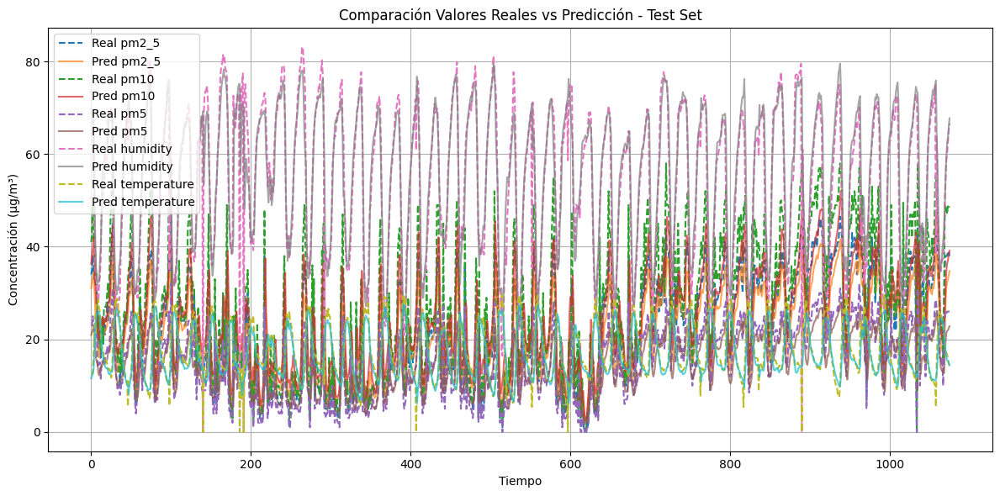

In [12]:
model_AQ2, preds_AQ2, y_test_AQ2, metrics_AQ2 = train_lstm_model_pm_variables(DF_AQ2)

/home/steven-laptop/Documentos/Estudio/Proyecto QAIR/air_quality/air2/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


34/34 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
📊 R²: 0.8961 | MAE: 2.8411 | RMSE: 4.3031


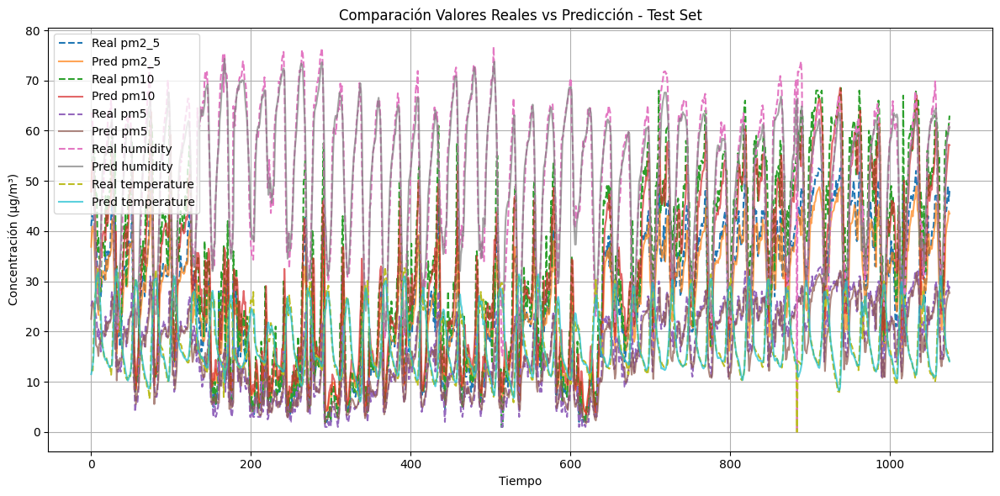

In [13]:
model_AQ1, preds_AQ1, y_test_AQ1, metrics_AQ1 = train_lstm_model_pm_variables(DF_AQ1)

/home/steven-laptop/Documentos/Estudio/Proyecto QAIR/air_quality/air2/lib/python3.10/site-packages/sklearn/base.py:493: FutureWarning: The feature names should match those that were passed during fit. Starting version 1.2, an error will be raised.
Feature names must be in the same order as they were in fit.

  warnings.warn(message, FutureWarning)
/tmp/ipykernel_10710/1150453167.py:48: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  future_index = pd.date_range(start=last_time + pd.Timedelta(hours=1),


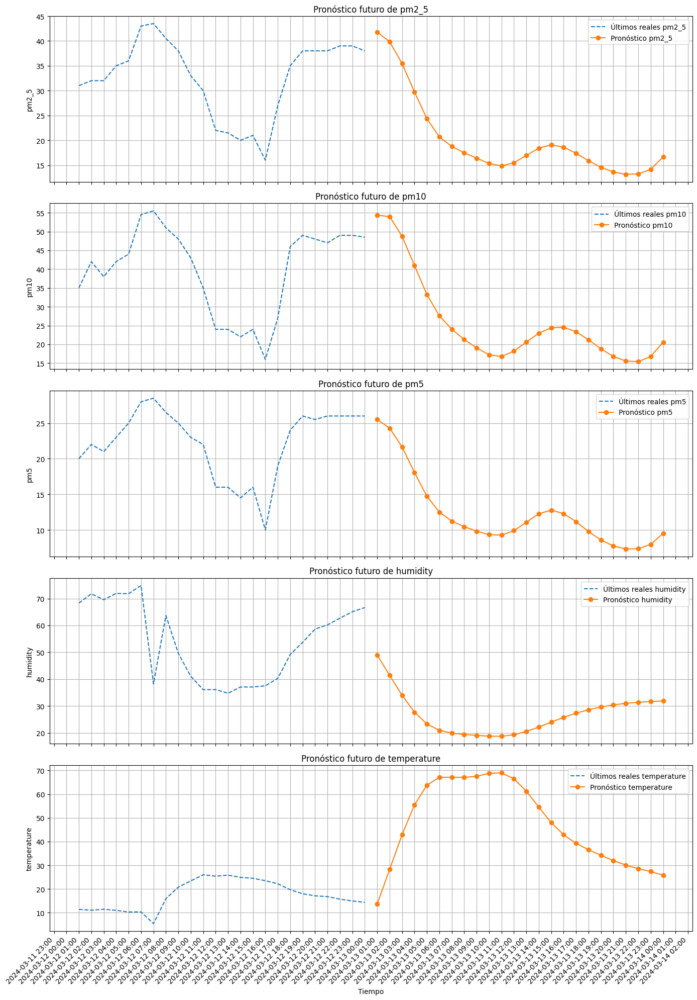

In [14]:
# ⚠️ Reutilizar el scaler
scaler = MinMaxScaler()
scaler.fit(DF_AQ2[['pm2_5', 'pm10', 'pm5','humidity','temperature']].dropna())

# Predicción futura
future_preds_AQ2 = predict_future_lstm(model_AQ2, DF_AQ2, scaler)



/home/steven-laptop/Documentos/Estudio/Proyecto QAIR/air_quality/air2/lib/python3.10/site-packages/sklearn/base.py:493: FutureWarning: The feature names should match those that were passed during fit. Starting version 1.2, an error will be raised.
Feature names must be in the same order as they were in fit.

  warnings.warn(message, FutureWarning)
/tmp/ipykernel_10710/1150453167.py:48: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  future_index = pd.date_range(start=last_time + pd.Timedelta(hours=1),


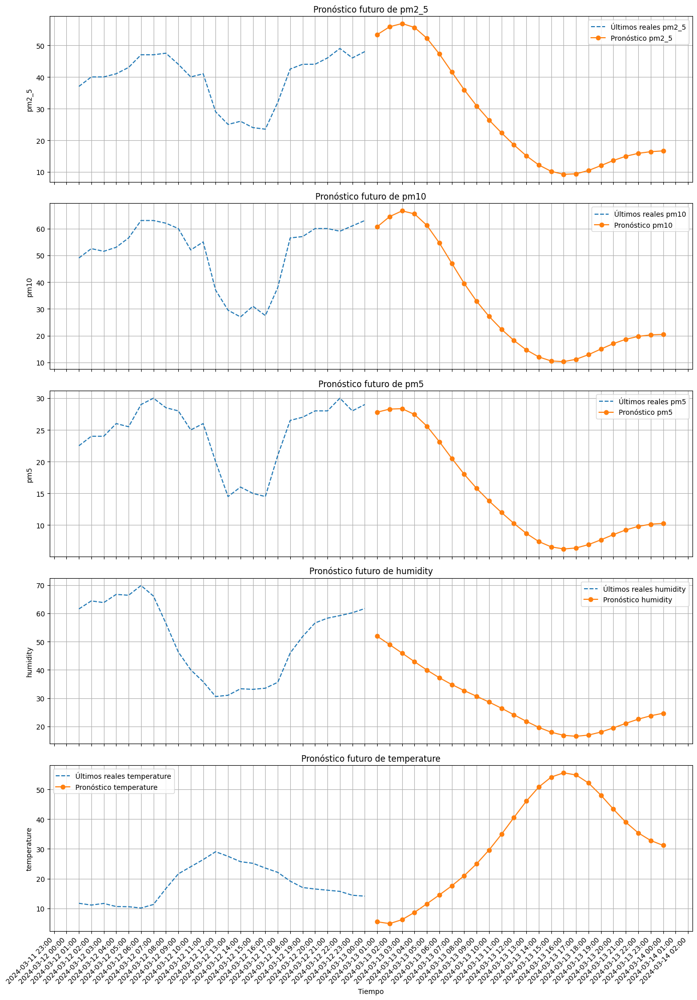

In [15]:
# ⚠️ Reutilizar el scaler
scaler = MinMaxScaler()
scaler.fit(DF_AQ1[['pm2_5', 'pm10', 'pm5','humidity','temperature']].dropna())

# Predicción futura
future_preds_AQ1 = predict_future_lstm(model_AQ1, DF_AQ1, scaler)



In [16]:

DF_AQ1_RS.index = pd.DatetimeIndex(DF_AQ1_RS.index).to_period('H').to_timestamp()
DF_AQ2_RS.index = pd.DatetimeIndex(DF_AQ2_RS.index).to_period('H').to_timestamp()


/tmp/ipykernel_10710/4018997528.py:1: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  DF_AQ1_RS.index = pd.DatetimeIndex(DF_AQ1_RS.index).to_period('H').to_timestamp()
/tmp/ipykernel_10710/4018997528.py:2: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  DF_AQ2_RS.index = pd.DatetimeIndex(DF_AQ2_RS.index).to_period('H').to_timestamp()


In [17]:
future_preds_AQ1

,pm2_5,pm10,pm5,humidity,temperature
2024-03-13 01:00:00,53.358387,60.635150,27.795697,51.890261,5.476829
2024-03-13 02:00:00,55.850812,64.472989,28.284824,48.920366,4.862479
2024-03-13 03:00:00,56.862825,66.602169,28.346102,45.931951,6.200328
2024-03-13 04:00:00,55.636546,65.477319,27.438522,42.885018,8.646933
2024-03-13 05:00:00,52.214819,61.166464,25.588207,39.921618,11.548509
2024-03-13 06:00:00,47.251528,54.620399,23.146158,37.202502,14.506416
2024-03-13 07:00:00,41.576971,47.023189,20.518574,34.791426,17.568588
2024-03-13 08:00:00,35.951133,39.495347,18.013956,32.645596,21.001733
2024-03-13 09:00:00,30.867880,32.820542,15.781764,30.633814,24.998452
2024-03-13 10:00:00,26.394824,27.185724,13.806723,28.589554,29.645374


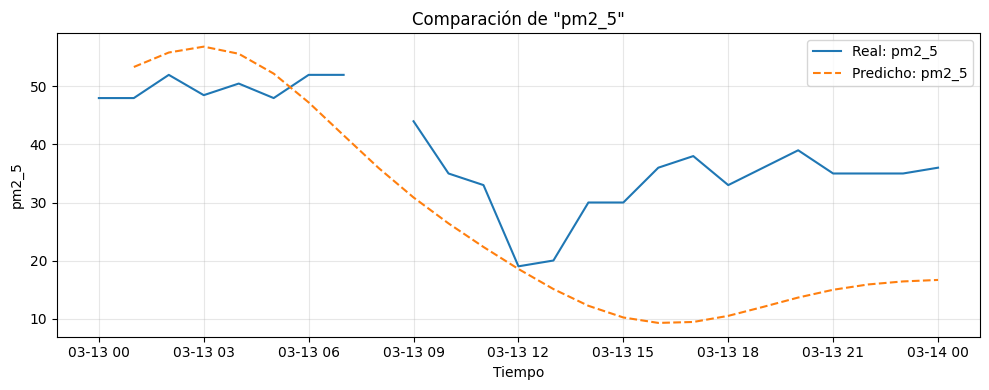

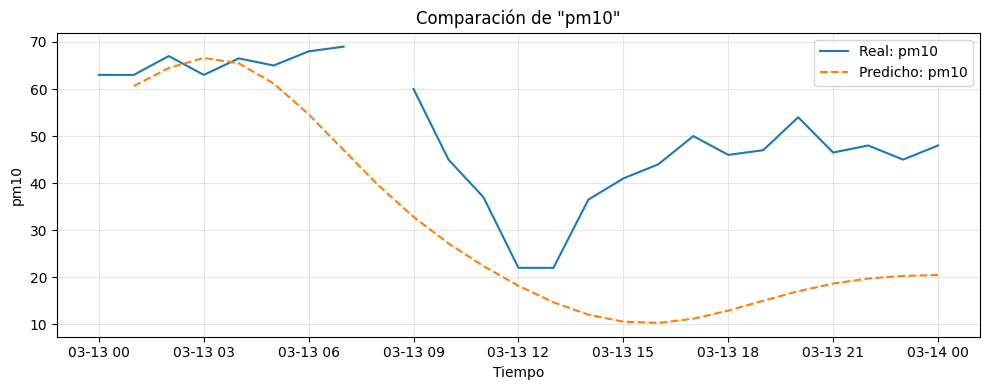

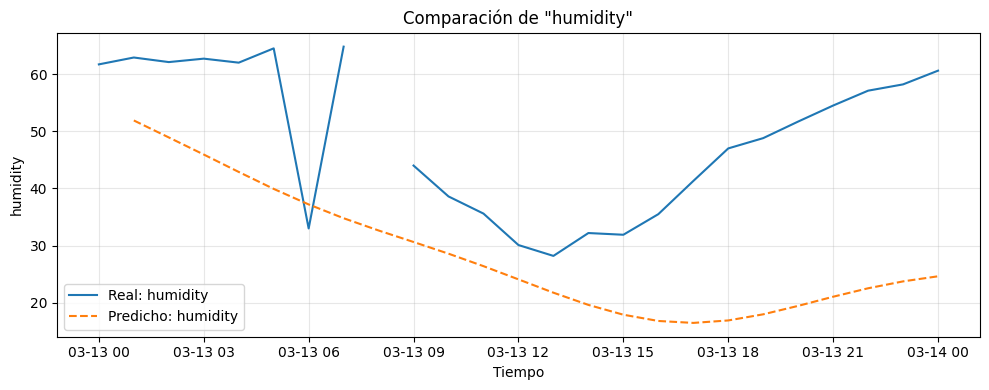

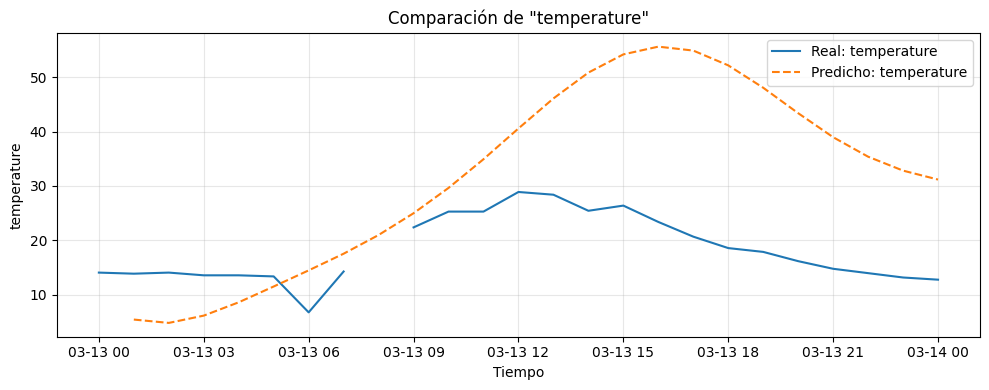

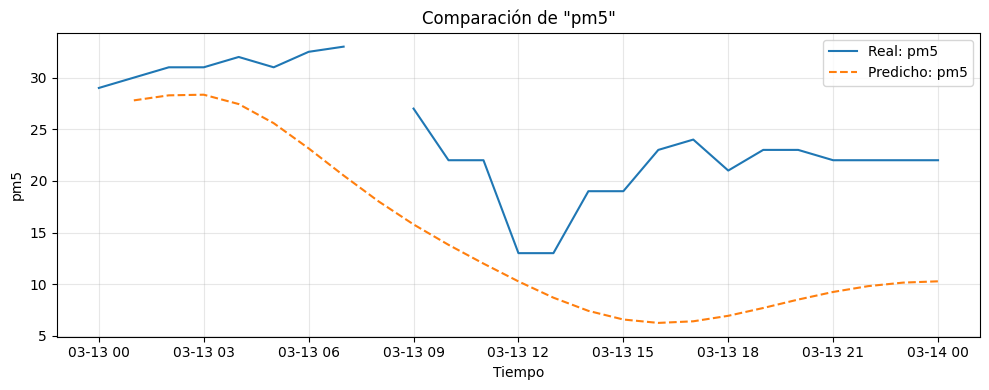

In [18]:
cols = ['pm2_5', 'pm10', 'humidity', 'temperature', 'pm5']
plot_comparative_index(DF_AQ1_RS, future_preds_AQ1, variables=cols)


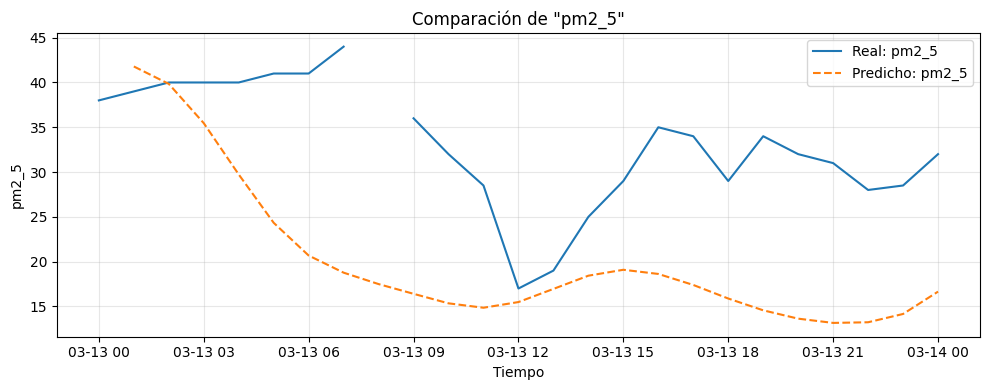

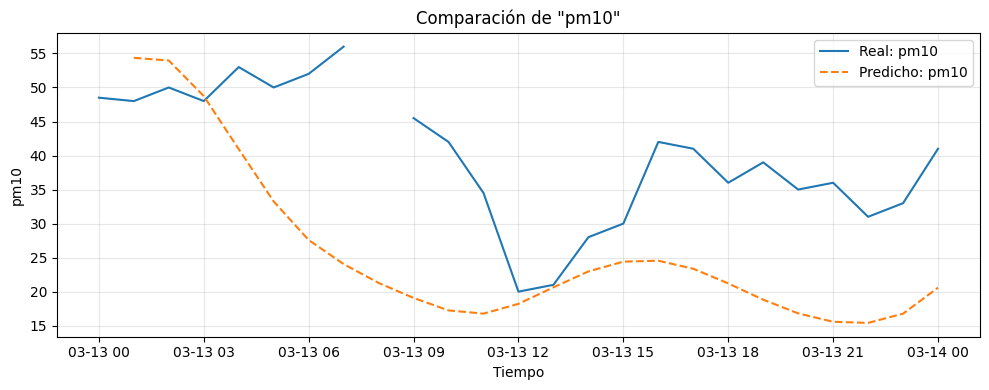

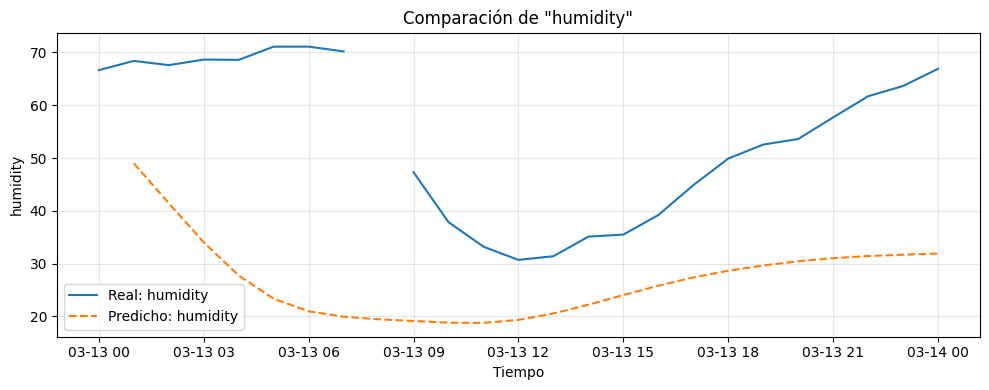

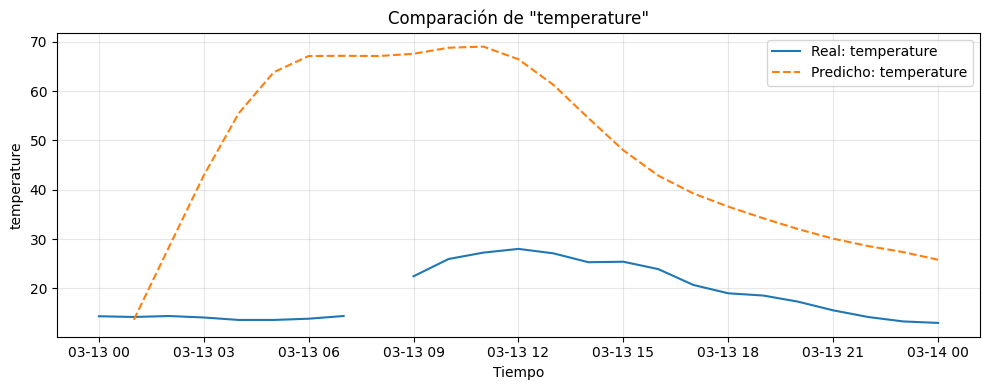

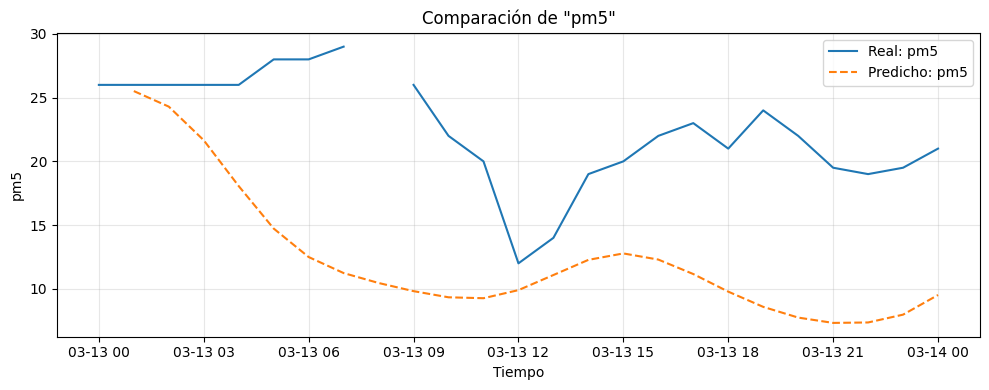

In [19]:
cols = ['pm2_5', 'pm10', 'humidity', 'temperature', 'pm5']
plot_comparative_index(DF_AQ2_RS, future_preds_AQ2, variables=cols)


In [21]:
def add_lat_lon(df: pd.DataFrame, lat: float, lon: float, aqsep: bool) -> pd.DataFrame:
    """
    Añade columnas de latitud y longitud a un DataFrame de calidad de aire.

    Parámetros
    ----------
    df : pandas.DataFrame
        DataFrame original con las columnas:
        'pm2_5', 'pm10', 'pm5', 'humidity', 'temperature'
    lat : float
        Valor de latitud a asignar a todas las filas.
    lon : float
        Valor de longitud a asignar a todas las filas.

    Retorna
    -------
    pandas.DataFrame
        Copia de `df` con dos columnas nuevas: 'lat' y 'lon'.
    """
    # Creamos una copia para no modificar el original
    df_copy = df.copy()
    
    # Añadimos las dos columnas
    df_copy['lat'] = lat
    df_copy['lon'] = lon
    
    # Reordenamos columnas opcionalmente
    if aqsep:
        cols = ['pm2_5', 'pm10', 'humidity', 'temperature', 'lat', 'lon']
    else:
        cols = ['pm2_5', 'pm10', 'pm5', 'humidity', 'temperature', 'lat', 'lon']
    return df_copy[cols]


CONCATENAR EL DATASET BASE CON LOS PREDICHOS

- DF_AQ2_RS + DF_AQ2
- DF_AQ1_RS + DF_AQ1
- DF_AQSEP_RS + DF_AQSEP


In [22]:
DF_AQ2_FULL = pd.concat([DF_AQ2, DF_AQ2_RS],ignore_index=False)
DF_AQ2_FULL

,pm2_5,pm10,humidity,temperature,pm5,co,o3
time_format,,,,,,,
2023-08-01 00:00:00,9.0,10.0,66.25,13.30,6.0,NaN,NaN
2023-08-01 01:00:00,6.0,7.0,68.30,12.90,4.0,NaN,NaN
2023-08-01 02:00:00,5.0,6.0,69.70,12.90,3.0,NaN,NaN
2023-08-01 03:00:00,7.0,8.0,70.50,12.65,4.0,NaN,NaN
2023-08-01 04:00:00,9.5,10.5,72.40,12.40,6.5,NaN,NaN
...,...,...,...,...,...,...,...
2024-03-13 20:00:00,32.0,35.0,53.60,17.30,22.0,14.0,None
2024-03-13 21:00:00,31.0,36.0,57.70,15.55,19.5,19.5,None
2024-03-13 22:00:00,28.0,31.0,61.70,14.20,19.0,18.0,None


In [23]:
DF_AQSEP_FULL = pd.concat([DF_AQSEP, DF_AQSEP_RS],ignore_index=False)
DF_AQSEP_FULL

,pm2_5,pm10,humidity,temperature,co,o3
time_format,,,,,,
2023-08-01 00:00:00,2.900,4.100,0.40,12.90,NaN,NaN
2023-08-01 01:00:00,2.700,2.900,0.40,12.55,NaN,NaN
2023-08-01 02:00:00,3.500,4.000,0.40,12.30,NaN,NaN
2023-08-01 03:00:00,2.500,3.200,0.40,12.00,NaN,NaN
2023-08-01 04:00:00,4.300,4.900,0.40,11.90,NaN,NaN
...,...,...,...,...,...,...
2024-03-13 20:00:00,0.850,0.860,68.60,15.80,33.40,0.200
2024-03-13 21:00:00,0.690,0.690,73.90,14.30,33.70,0.195
2024-03-13 22:00:00,0.550,0.550,77.05,13.40,33.40,0.170


In [24]:
DF_AQ1_FULL = pd.concat([DF_AQ1, DF_AQ1_RS],ignore_index=False)

In [25]:
lat_est1, lon_est1 = 5.820085208854201, -73.02437718465804

DF_AQ1_COR = add_lat_lon(DF_AQ1_FULL, lat=lat_est1, lon=lon_est1, aqsep=False)
DF_AQ1_COR.head()

,pm2_5,pm10,pm5,humidity,temperature,lat,lon
time_format,,,,,,,
2023-08-01 00:00:00,7.0,9.0,4.0,60.6,13.3,5.820085,-73.024377
2023-08-01 01:00:00,9.0,10.0,5.0,63.5,12.9,5.820085,-73.024377
2023-08-01 02:00:00,7.0,11.0,4.0,64.8,12.8,5.820085,-73.024377
2023-08-01 03:00:00,7.0,8.0,4.0,66.0,12.5,5.820085,-73.024377
2023-08-01 04:00:00,9.0,10.0,6.0,67.3,12.3,5.820085,-73.024377


In [26]:
lat_est1, lon_est1 = 5.826250, -73.031472

DF_AQ2_COR = add_lat_lon(DF_AQ2_FULL, lat=lat_est1, lon=lon_est1, aqsep=False)
DF_AQ2_COR.head()

,pm2_5,pm10,pm5,humidity,temperature,lat,lon
time_format,,,,,,,
2023-08-01 00:00:00,9.0,10.0,6.0,66.25,13.30,5.82625,-73.031472
2023-08-01 01:00:00,6.0,7.0,4.0,68.30,12.90,5.82625,-73.031472
2023-08-01 02:00:00,5.0,6.0,3.0,69.70,12.90,5.82625,-73.031472
2023-08-01 03:00:00,7.0,8.0,4.0,70.50,12.65,5.82625,-73.031472
2023-08-01 04:00:00,9.5,10.5,6.5,72.40,12.40,5.82625,-73.031472


In [27]:

lat_est1, lon_est1 = 5.820089909104576, -73.02821013704097

DF_AQSEP_COR = add_lat_lon(DF_AQSEP_FULL, lat=lat_est1, lon=lon_est1, aqsep=True)
DF_AQSEP_COR.head()

,pm2_5,pm10,humidity,temperature,lat,lon
time_format,,,,,,
2023-08-01 00:00:00,2.9,4.1,0.4,12.90,5.82009,-73.02821
2023-08-01 01:00:00,2.7,2.9,0.4,12.55,5.82009,-73.02821
2023-08-01 02:00:00,3.5,4.0,0.4,12.30,5.82009,-73.02821
2023-08-01 03:00:00,2.5,3.2,0.4,12.00,5.82009,-73.02821
2023-08-01 04:00:00,4.3,4.9,0.4,11.90,5.82009,-73.02821


Objetivo 2

- Para cumplir el Objetivo 2 se aplicó Interpolación Espacial con ponderación por distancia inversa (IDW) sobre las predicciones de las tres estaciones y se representaron los resultados mediante mapas de calor (heatmaps) de PM₂.₅ (o la variable escogida) en toda el área de estudio

1. Prepara un único DataFrame con todas las estaciones

Al unirlas en una sola tabla, cada fila te dice “hora, quién mide y cuánto mide” y en un solo vistazo. De ese modo, podemos trabajar con los tres datos de las 00:00. “filtramos por hora = 00:00” y ya tienemos las tres filas juntas.

In [28]:
# 0. Si time_format es tu índice, conviértelo en columna
DF_AQ1_COR   = DF_AQ1_COR.reset_index()   # crea columna 'time_format'
DF_AQ2_COR   = DF_AQ2_COR.reset_index()
DF_AQSEP_COR = DF_AQSEP_COR.reset_index()

# 1. Etiqueta cada DataFrame con el nombre de su estación
DF_AQ1_COR['station']   = 'AQ1'
DF_AQ2_COR['station']   = 'AQ2'
DF_AQSEP_COR['station'] = 'AQSEP'

# 2. Ahora concatena todo y verás la columna time_format como tal
df_all = pd.concat([DF_AQ1_COR, DF_AQ2_COR, DF_AQSEP_COR],
                   ignore_index=True)

# Comprueba
print(df_all.columns)
# debería incluir: ['time_format', 'pm2_5', ..., 'lat', 'lon', 'station']


Index(['time_format', 'pm2_5', 'pm10', 'pm5', 'humidity', 'temperature', 'lat',
       'lon', 'station'],
      dtype='object')


2. Crea la “malla” (grid) de puntos sobre Duitama - generar una rejilla regular de puntos (latitud–longitud) 

- #1
- df_all.lat.min() toma la latitud menor de todas tus estaciones (punto más “al sur”).
- df_all.lat.max() toma la latitud mayor (punto más “al norte”).
- Lo mismo para lon (longitud más “al oeste” y más “al este”).

- #2
- Fija la resolución de la rejilla. Cada punto de la malla estará separado por 0.002 grados en latitud y longitud (aprox. 200 m en el ecuador; en Duitama, un poco menos).

- #3
- mesh_lon es una matriz de tamaño (n_lats × n_lons) donde cada fila es idéntica y repite el vector grid_lons.
- mesh_lat es otra matriz (n_lats × n_lons) donde cada columna repite grid_lats.
Juntas describen todas las combinaciones de (lat, lon) en tu rejilla.

In [ ]:
# 1. Extrae mínimos y máximos de lat/lon de tus estaciones
lat_min, lat_max = df_all.lat.min(), df_all.lat.max()
lon_min, lon_max = df_all.lon.min(), df_all.lon.max()

# 2. Define un paso (ej. 0.002° ≈ 200 m)
step = 0.0001
grid_lats = np.arange(lat_min, lat_max + step, step)
grid_lons = np.arange(lon_min, lon_max + step, step)

# 3. Crea la malla 2D
mesh_lon, mesh_lat = np.meshgrid(grid_lons, grid_lats)
flat_points = np.vstack([mesh_lat.ravel(), mesh_lon.ravel()]).T


lat_min  5.820085208854201
lon_min  -73.031472


In [44]:
# 1) Extrae los extremos originales
lat_min, lat_max = df_all.lat.min(), df_all.lat.max()
lon_min, lon_max = df_all.lon.min(), df_all.lon.max()

# 2) Calcula el rango en cada dirección
lat_range = lat_max - lat_min
lon_range = lon_max - lon_min

# 3) Define un padding del 10 % (puedes probar con 5 % o 15 %)
pad_frac = 0.10
pad_lat = lat_range * pad_frac
pad_lon = lon_range * pad_frac

# 4) Aplica el buffer
lat_min_pad = lat_min - pad_lat
lat_max_pad = lat_max + pad_lat
lon_min_pad = lon_min - pad_lon
lon_max_pad = lon_max + pad_lon

# 5) Genera la rejilla ampliada
step = 0.0001       # tu resolución
grid_lats = np.arange(lat_min_pad, lat_max_pad + step, step)
grid_lons = np.arange(lon_min_pad, lon_max_pad + step, step)
mesh_lon, mesh_lat = np.meshgrid(grid_lons, grid_lats)
flat_points = np.vstack([mesh_lat.ravel(), mesh_lon.ravel()]).T


3. Función para interpolar con IDW y dibujar el heatmap

In [45]:
def plot_heatmap_for_time(df_all, mesh_lat, mesh_lon, flat_points, t, variable='pm2_5'):
    """
    Para el instante t (datetime), interpola con IDW y dibuja un heatmap de 'variable'.
    """
    # 1. Filtra las 3 estaciones en el tiempo t
    df_t = df_all[df_all.time_format == t]
    coords = df_t[['lat','lon']].values          # [[lat1, lon1],[lat2, lon2],[lat3, lon3]]
    vals   = df_t[variable].values               # [v1, v2, v3]
    
    # 2. Crea el árbol de distancias
    tree = cKDTree(coords)
    dists, idxs = tree.query(flat_points, k=3)   # k=3 porque son 3 estaciones
    pesos = 1.0 / (dists**2 + 1e-6)               # inverso distancia^2
    
    # 3. Interpola: suma(peso_i·v_i)/suma(peso_i)
    numer = (pesos * vals[idxs]).sum(axis=1)
    denom = pesos.sum(axis=1)
    grid_vals = (numer/denom).reshape(mesh_lon.shape)
    
    # 4. Dibuja heatmap con pcolormesh
    plt.figure(figsize=(7,6))
    plt.pcolormesh(
        mesh_lon, mesh_lat,
        grid_vals,
        shading='auto'
    )
    plt.scatter(
        coords[:,1], coords[:,0],
        c=vals, edgecolor='white', s=100, label='Estaciones'
    )
    plt.colorbar(label=f'{variable} (µg/m³)')
    plt.title(f'Heatmap {variable} interpolada\n{t}')
    plt.xlabel('Longitud')
    plt.ylabel('Latitud')
    plt.legend()
    plt.tight_layout()
    plt.show()


In [46]:
timestamps = sorted(df_all.time_format.unique())
t0 = '2024-03-13 01:00:00'

In [32]:
timestamps

[Timestamp('2023-08-01 00:00:00'),
 Timestamp('2023-08-01 01:00:00'),
 Timestamp('2023-08-01 02:00:00'),
 Timestamp('2023-08-01 03:00:00'),
 Timestamp('2023-08-01 04:00:00'),
 Timestamp('2023-08-01 05:00:00'),
 Timestamp('2023-08-01 06:00:00'),
 Timestamp('2023-08-01 07:00:00'),
 Timestamp('2023-08-01 08:00:00'),
 Timestamp('2023-08-01 09:00:00'),
 Timestamp('2023-08-01 10:00:00'),
 Timestamp('2023-08-01 11:00:00'),
 Timestamp('2023-08-01 12:00:00'),
 Timestamp('2023-08-01 13:00:00'),
 Timestamp('2023-08-01 14:00:00'),
 Timestamp('2023-08-01 15:00:00'),
 Timestamp('2023-08-01 16:00:00'),
 Timestamp('2023-08-01 17:00:00'),
 Timestamp('2023-08-01 18:00:00'),
 Timestamp('2023-08-01 19:00:00'),
 Timestamp('2023-08-01 20:00:00'),
 Timestamp('2023-08-01 21:00:00'),
 Timestamp('2023-08-01 22:00:00'),
 Timestamp('2023-08-01 23:00:00'),
 Timestamp('2023-08-02 00:00:00'),
 Timestamp('2023-08-02 01:00:00'),
 Timestamp('2023-08-02 02:00:00'),
 Timestamp('2023-08-02 03:00:00'),
 Timestamp('2023-08-

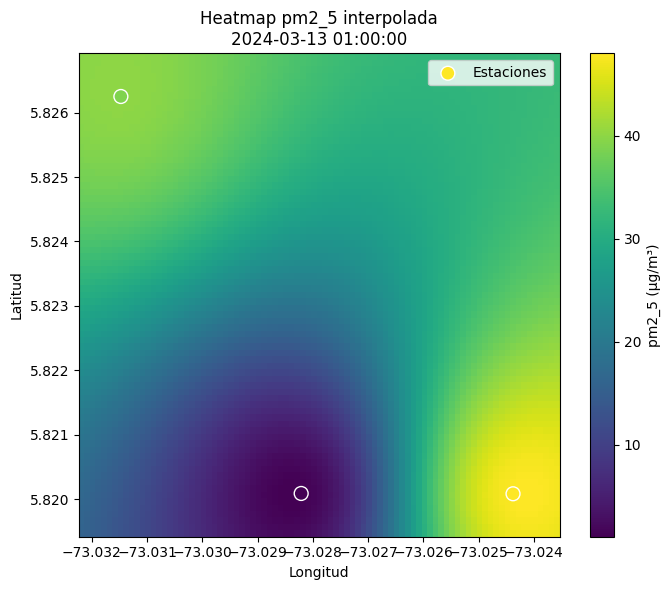

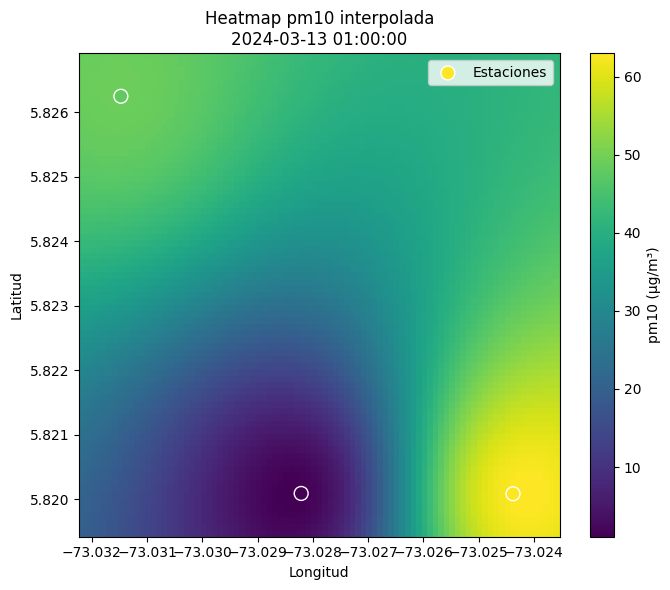

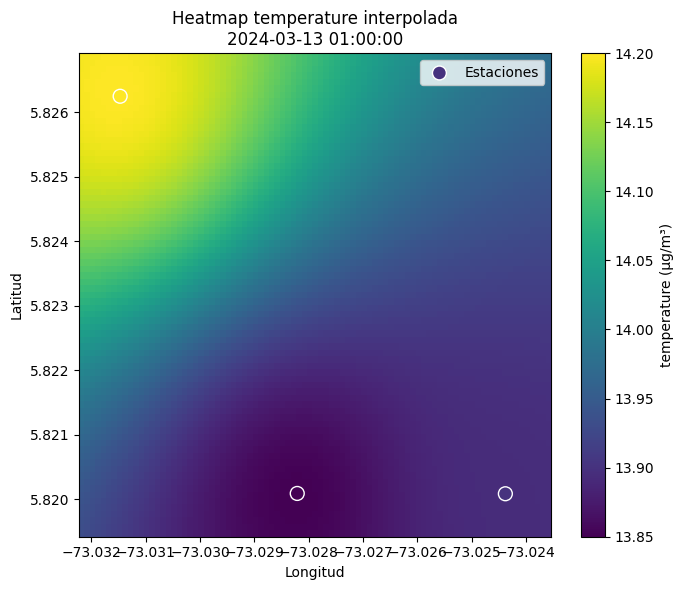

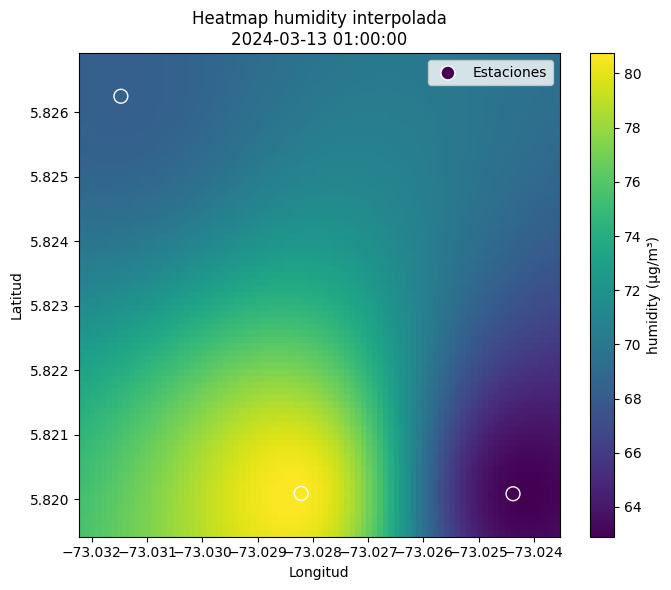

In [47]:
plot_heatmap_for_time(df_all, mesh_lat, mesh_lon, flat_points, t0, variable='pm2_5')
plot_heatmap_for_time(df_all, mesh_lat, mesh_lon, flat_points, t0, variable='pm10')
plot_heatmap_for_time(df_all, mesh_lat, mesh_lon, flat_points, t0, variable='temperature')
plot_heatmap_for_time(df_all, mesh_lat, mesh_lon, flat_points, t0, variable='humidity')


In [48]:
def plot_heatmap_on_map(df_all, mesh_lat, mesh_lon, flat_points, t, variable='pm2_5'):
    # 1. Filtra datos en t
    df_t    = df_all[df_all.time_format == t]
    coords  = df_t[['lat','lon']].values
    values  = df_t[variable].values

    # 2. IDW sobre la rejilla
    tree    = cKDTree(coords)
    dists, idxs = tree.query(flat_points, k=3)
    pesos   = 1/(dists**2 + 1e-6)
    numer   = (pesos * values[idxs]).sum(axis=1)
    denom   = pesos.sum(axis=1)
    grid    = (numer/denom).reshape(mesh_lon.shape)

    # 3. Construye GeoDataFrame de la rejilla
    df_mesh = gpd.GeoDataFrame({
        'value': grid.ravel(),
        'geometry': [Point(xy) for xy in zip(mesh_lon.ravel(), mesh_lat.ravel())]
    }, crs="EPSG:4326")

    # 4. GeoDataFrame de estaciones
    df_stn = gpd.GeoDataFrame(
        df_t[['station','lat','lon']].drop_duplicates(),
        geometry=gpd.points_from_xy(df_t.lon, df_t.lat),
        crs="EPSG:4326"
    )

    # 5. Reproyecta a Web Mercator
    df_mesh = df_mesh.to_crs(epsg=3857)
    df_stn  = df_stn.to_crs(epsg=3857)

    # 6. Plot sobre basemap de OSM
    ax = df_mesh.plot(
        column='value',
        cmap='inferno',
        markersize=1,
        alpha=0.6,
        legend=True,
        legend_kwds={'label': f"{variable} (µg/m³)"}
    )
    df_stn.plot(
        ax=ax,
        color='black',
        edgecolor='white',
        markersize=60,
        label='Estaciones'
    )
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
    ax.set_axis_off()
    ax.set_title(f"Heatmap {variable} interpolada\n{t}")
    ax.legend()
    plt.tight_layout()
    plt.show()


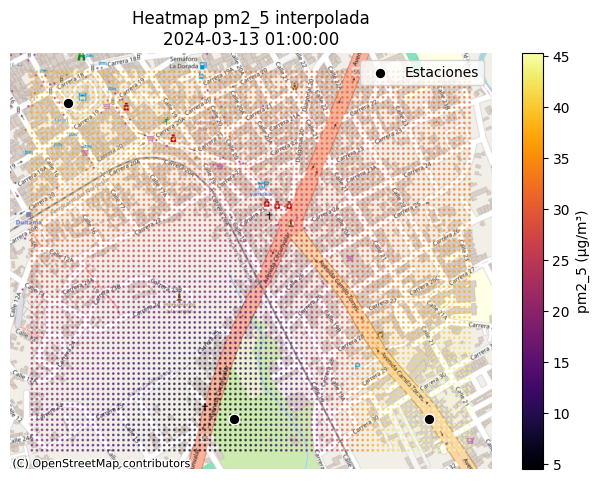

In [49]:
plot_heatmap_on_map(df_all, mesh_lat, mesh_lon, flat_points, t0, variable='pm2_5')


In [50]:
# Cargar el contorno de Duitama una sola vez
# Esto bajará el límite administrativo de OpenStreetMap
# Puedes mover esta línea fuera de la función para cachear el resultado
gdf_duitama = ox.geocode_to_gdf("Duitama, Boyacá, Colombia", which_result=1)
gdf_duitama = gdf_duitama.to_crs(epsg=4326)

def plot_heatmap_for_time(
    df_all,
    mesh_lat,
    mesh_lon,
    flat_points,
    t,
    variable='pm2_5',
    step=None
):
    """
    Para el instante t (datetime), interpola con IDW y dibuja un heatmap de 'variable',
    superponiendo el contorno de Duitama.
    """
    # 1. Filtrar los datos en el tiempo t
    df_t = df_all[df_all.time_format == t]
    coords = df_t[['lat', 'lon']].values  # [[lat1, lon1], [lat2, lon2], [lat3, lon3]]
    vals = df_t[variable].values          # [v1, v2, v3]

    # 2. Determinar el paso de la rejilla (si no se proporciona)
    if step is None:
        step = mesh_lat[1, 0] - mesh_lat[0, 0]

    # 3. Interpolación IDW
    tree = cKDTree(coords)
    dists, idxs = tree.query(flat_points, k=coords.shape[0])
    pesos = 1.0 / (dists**2 + 1e-6)
    numer = (pesos * vals[idxs]).sum(axis=1)
    denom = pesos.sum(axis=1)
    grid_vals = (numer / denom).reshape(mesh_lon.shape)

    # 4. Crear la figura y dibujar el heatmap
    fig, ax = plt.subplots(figsize=(7, 6))
    im = ax.pcolormesh(
        mesh_lon,
        mesh_lat,
        grid_vals,
        shading='auto',
        cmap='inferno'
    )

    # 5. Superponer las estaciones
    ax.scatter(
        coords[:, 1],
        coords[:, 0],
        c=vals,
        edgecolor='white',
        s=100,
        label='Estaciones'
    )

    # 6. Superponer el contorno de Duitama
    gdf_duitama.boundary.plot(
        ax=ax,
        edgecolor='black',
        linewidth=2,
        label='Límite de Duitama'
    )

    # 7. Agregar colorbar
    cbar = fig.colorbar(im, ax=ax, fraction=0.036, pad=0.04)
    cbar.ax.set_ylabel(f'{variable} (µg/m³)', rotation=270, labelpad=15)

    # 8. Ajustes finales
    ax.set_xlabel('Longitud')
    ax.set_ylabel('Latitud')
    ax.set_title(f'Heatmap {variable} interpolada en Duitama\n{t}')
    ax.legend(loc='lower right')
    plt.tight_layout()
    plt.show()

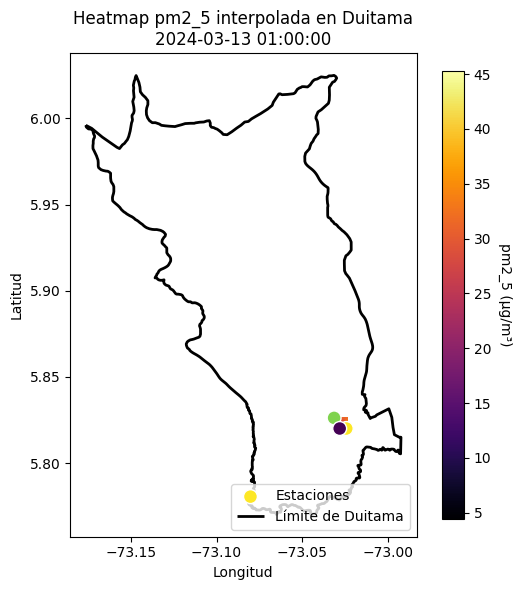

In [51]:
t0 = pd.to_datetime("2024-03-13 01:00:00")

# Llama a la función
plot_heatmap_for_time(
    df_all,
    mesh_lat,
    mesh_lon,
    flat_points,
    t0,
    variable='pm2_5'
)

In [38]:
def plot_heatmap_duitama(
    df_all, 
    mesh_lat, 
    mesh_lon, 
    flat_points, 
    t, 
    variable='pm2_5', 
    center_lat=5.8254, 
    center_lon=-73.0366
):
    """
    Crea un mapa de calor georreferenciado de Duitama con Folium.
    
    Parámetros:
    - df_all: DataFrame con todos los datos
    - mesh_lat: Malla de latitudes
    - mesh_lon: Malla de longitudes
    - flat_points: Puntos aplanados de la malla
    - t: Tiempo específico para el análisis
    - variable: Variable a interpolar ('pm2_5', 'pm10', etc.)
    - center_lat: Latitud central de Duitama
    - center_lon: Longitud central de Duitama
    """
    # 1. Filtra datos para el tiempo específico
    df_t = df_all[df_all.time_format == t]
    coords = df_t[['lat','lon']].values
    vals = df_t[variable].values
    
    # 2. Interpolación IDW
    tree = cKDTree(coords)
    dists, idxs = tree.query(flat_points, k=3)
    pesos = 1.0 / (dists**2 + 1e-6)
    
    numer = (pesos * vals[idxs]).sum(axis=1)
    denom = pesos.sum(axis=1)
    grid_vals = (numer/denom).reshape(mesh_lon.shape)
    
    # 3. Prepara datos para Folium
    # Combina malla de latitud, longitud y valores interpolados
    heat_data = []
    for lat, lon, val in zip(mesh_lat.ravel(), mesh_lon.ravel(), grid_vals.ravel()):
        heat_data.append([lat, lon, val])
    
    # 4. Crea mapa base de Duitama
    m = folium.Map(
        location=[center_lat, center_lon], 
        zoom_start=13,
        tiles='cartodbpositron'
    )
    
    # 5. Añade capa de calor
    HeatMap(
        heat_data, 
        name=f'Heatmap {variable}',
        min_opacity=0.4,
        max_opacity=0.8,
        radius=15,  # Tamaño de cada punto de calor
        blur=10     # Difuminado
    ).add_to(m)
    
    # 6. Añade marcadores de estaciones originales
    for idx, row in df_t.iterrows():
        folium.CircleMarker(
            location=[row['lat'], row['lon']],
            radius=5,
            popup=f"{row['station']}: {row[variable]} {variable}",
            color='red',
            fill=True,
            fillColor='red'
        ).add_to(m)
    
    # 7. Información de rango de valores
    min_val = grid_vals.min()
    max_val = grid_vals.max()
    mean_val = grid_vals.mean()
    
    folium.map.Marker(
        [center_lat, center_lon],
        icon=folium.DivIcon(
            icon_size=(250,36),
            icon_anchor=(0,0),
            html=f"""
            <div style="background-color: white; padding: 10px; border: 1px solid black;">
            <b>Rango de {variable}</b><br>
            Mín: {min_val:.2f}<br>
            Máx: {max_val:.2f}<br>
            Promedio: {mean_val:.2f}
            </div>
            """
        )
    ).add_to(m)
    
    return m

# Uso de ejemplo (descomentar si se requiere)
# mapa = plot_heatmap_duitama(df_all, mesh_lat, mesh_lon, flat_points, t0, 'pm2_5')
# mapa.save('duitama_heatmap.html')

In [39]:
# Uso de ejemplo (descomentar si se requiere)
mapa = plot_heatmap_duitama(df_all, mesh_lat, mesh_lon, flat_points, t0, 'pm2_5')
mapa.save('duitama_heatmap.html')

In [40]:
def plot_heatmap_geopandas(
    df_all, 
    mesh_lat, 
    mesh_lon, 
    flat_points, 
    t, 
    variable='pm2_5', 
    center_lat=5.8254, 
    center_lon=-73.0366,
    cmap='viridis',
    basemap_provider=None,
    margin_factor=0.2  # Factor de margen para zoom out
):
    """
    Crea un mapa de calor georreferenciado de Duitama usando GeoPandas con mapa base.
    
    Parámetros adicionales:
    - margin_factor: Porcentaje de expansión del área del mapa (0.2 = 20% de margen)
    """
    # 1. Filtra datos para el tiempo específico
    df_t = df_all[df_all.time_format == t]
    
    # 2. Crea GeoDataFrame para las estaciones
    gdf_stations = gpd.GeoDataFrame(
        df_t, 
        geometry=[Point(lon, lat) for lon, lat in zip(df_t['lon'], df_t['lat'])],
        crs="EPSG:4326"
    )
    
    # 3. Interpolación IDW
    coords = df_t[['lat','lon']].values
    vals = df_t[variable].values
    
    tree = cKDTree(coords)
    dists, idxs = tree.query(flat_points, k=3)
    pesos = 1.0 / (dists**2 + 1e-6)
    
    numer = (pesos * vals[idxs]).sum(axis=1)
    denom = pesos.sum(axis=1)
    grid_vals = (numer/denom).reshape(mesh_lon.shape)
    
    # 4. Crea GeoDataFrame para la malla interpolada
    gdf_grid = gpd.GeoDataFrame(
        {
            'geometry': [Point(lon, lat) for lon, lat in zip(mesh_lon.ravel(), mesh_lat.ravel())],
            variable: grid_vals.ravel()
        },
        crs="EPSG:4326"
    )
    
    # 5. Reproyecta a un sistema de coordenadas compatible con mapas base
    gdf_stations_merc = gdf_stations.to_crs(epsg=3857)
    gdf_grid_merc = gdf_grid.to_crs(epsg=3857)
    
    # 6. Configuración de la visualización
    fig, ax = plt.subplots(figsize=(15, 12), dpi=300)
    
    
    # Dibuja el mapa de calor con transparencia
    scatter = gdf_grid_merc.plot(
        column=variable, 
        cmap=cmap, 
        alpha=0.6, 
        edgecolor='none', 
        ax=ax,
        legend=True,
        legend_kwds={
            'label': f'{variable} Interpolado', 
            'orientation': 'vertical'
        },
        aspect='equal'
    )
    
    # 7. Añade mapa base
    # Lista de proveedores alternativos
    basemap_providers = [
        cx.providers.OpenStreetMap.Mapnik,
        cx.providers.CartoDB.Positron,
        cx.providers.CartoDB.Voyager
    ]
    
    # Elige un proveedor de mapa base
    if basemap_provider:
        try:
            cx.add_basemap(ax, source=basemap_provider)
        except Exception as e:
            print(f"Error con el proveedor de mapa personalizado: {e}")
            print("Usando proveedor de mapa por defecto.")
            cx.add_basemap(ax, source=cx.providers.OpenStreetMap.Mapnik)
    else:
        # Intenta proveedores en orden
        for provider in basemap_providers:
            try:
                cx.add_basemap(ax, source=provider)
                break
            except Exception as e:
                print(f"Error con proveedor {provider}: {e}")
                continue
    
    # Añade puntos de estaciones
    gdf_stations_merc.plot(
        ax=ax, 
        color='red', 
        markersize=100, 
        marker='*', 
        label='Estaciones',
        zorder=10  # Asegura que los puntos estén sobre el mapa base
    )

    for idx, row in gdf_stations_merc.iterrows():
        # Convierte coordenadas de mercator a geográficas originales
        orig_point = gpd.GeoDataFrame(geometry=[row.geometry], crs=gdf_stations_merc.crs).to_crs(epsg=4326).geometry[0]
        
        # Prepara texto de etiqueta
        label_text = (
            f"{row['station']}"
        )
        
        # Añade anotación
        plt.annotate(
            label_text, 
            (row.geometry.x, row.geometry.y),
            xytext=(7,7),  # Desplazamiento de la etiqueta
            textcoords='offset points',
            fontsize=9,
            color='darkred',
            fontweight='bold',
            bbox=dict(
                boxstyle='round,pad=0.2', 
                fc='yellow', 
                alpha=0.7
            ),
            zorder=11  # Asegura que la etiqueta esté sobre todo lo demás
        )
    
    # 8. Cálculo de límites con margen
    bounds = gdf_grid_merc.total_bounds
    
    # Calcula márgenes
    width = bounds[2] - bounds[0]
    height = bounds[3] - bounds[1]
    
    # Añade márgenes
    margin_x = width * margin_factor
    margin_y = height * margin_factor
    
    # Establece límites con margen
    ax.set_xlim(
        bounds[0] - margin_x, 
        bounds[2] + margin_x
    )
    ax.set_ylim(
        bounds[1] - margin_y, 
        bounds[3] + margin_y
    )
    
    # Personalización del mapa
    ax.set_title(f'Mapa de Calor de {variable} en Duitama\n{t}', fontsize=15)
    ax.set_xlabel('Longitud', fontsize=12)
    ax.set_ylabel('Latitud', fontsize=12)
    
    plt.legend(loc='best')
    plt.tight_layout()
    
    # Información adicional de estadísticas
    print(f"Estadísticas de {variable}:")
    print(f"Mínimo: {grid_vals.min():.2f}")
    print(f"Máximo: {grid_vals.max():.2f}")
    print(f"Promedio: {grid_vals.mean():.2f}")
    
    return fig, ax, gdf_grid, gdf_stations

# Ejemplo de uso
# Uso básico con margen por defecto (20%)
# fig_pm25, ax_pm25, gdf_grid_pm25, gdf_stations_pm25 = plot_heatmap_geopandas(
#     df_all, mesh_lat, mesh_lon, flat_points, t0, 'pm2_5'
# )
# plt.show()

# Uso con margen personalizado (por ejemplo, 30%)
# fig_pm25, ax_pm25, gdf_grid_pm25, gdf_stations_pm25 = plot_heatmap_geopandas(
#     df_all, mesh_lat, mesh_lon, flat_points, t0, 'pm2_5',
#     margin_factor=0.3
# )
# plt.show()

Estadísticas de pm2_5:
Mínimo: 4.44
Máximo: 45.13
Promedio: 25.78


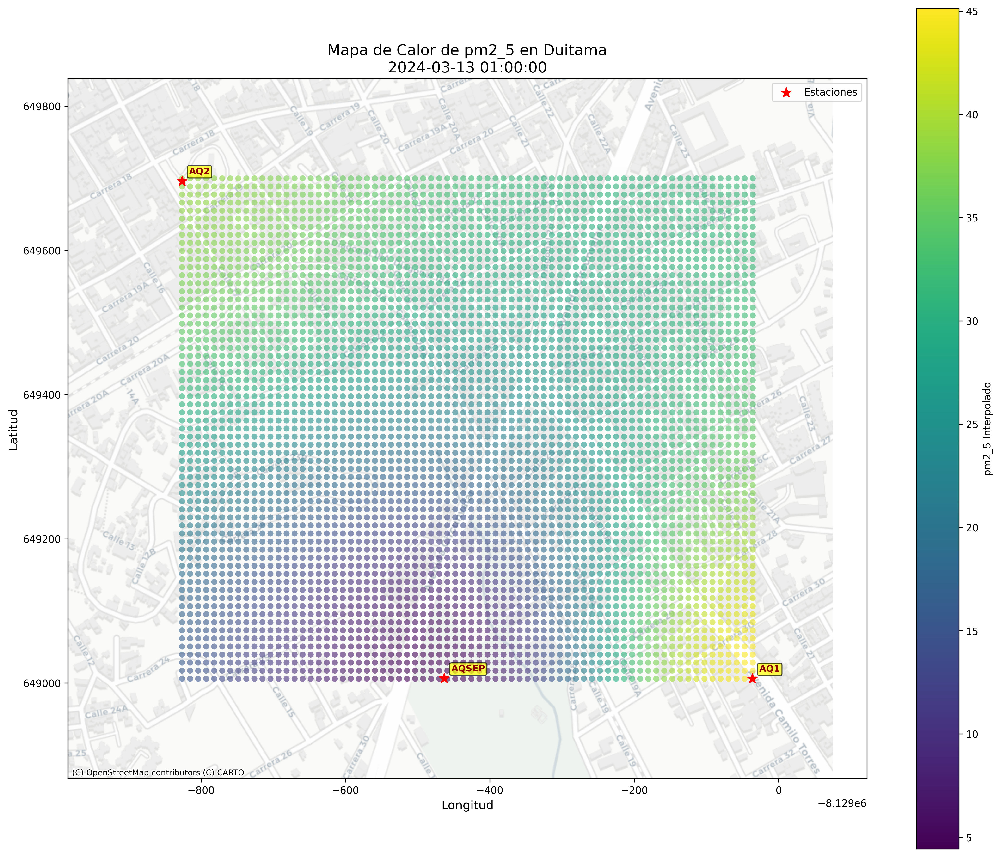

In [41]:
fig_pm25, ax_pm25, gdf_grid_pm25, gdf_stations_pm25 = plot_heatmap_geopandas(
    df_all, mesh_lat, mesh_lon, flat_points, t0, 'pm2_5',
    basemap_provider=cx.providers.CartoDB.Positron,
)
plt.show()

Estadísticas de pm10:
Mínimo: 5.46
Máximo: 59.18
Promedio: 32.70


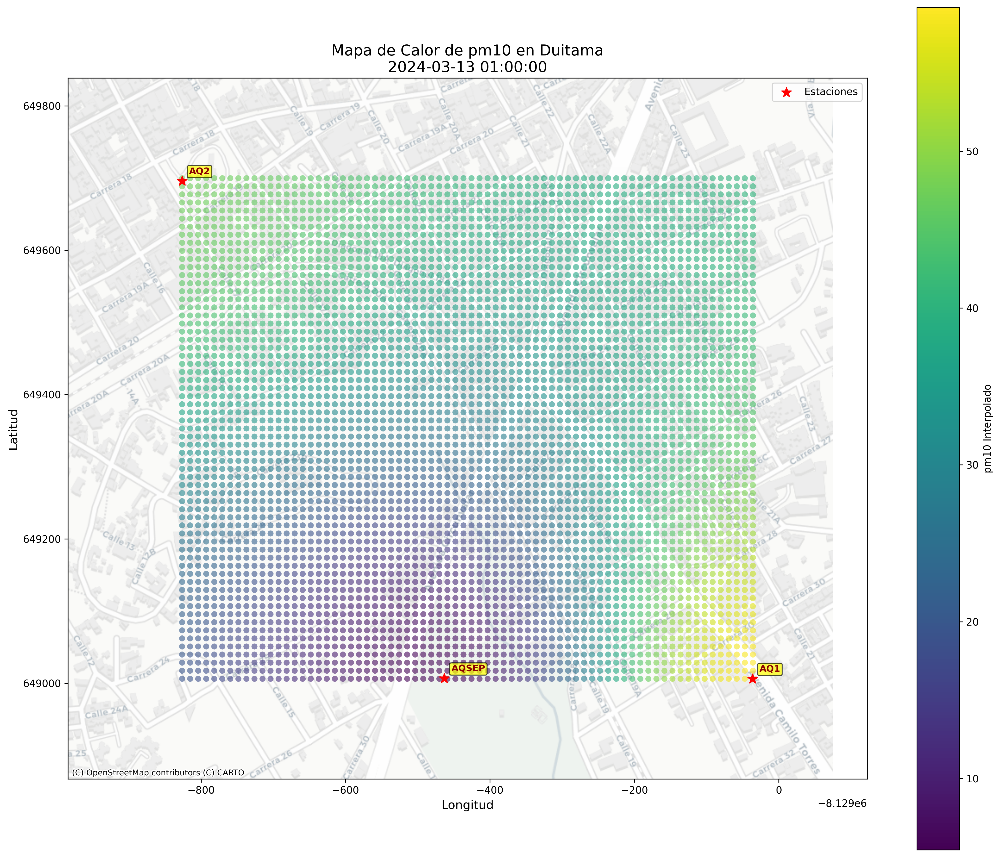

In [51]:
fig_pm25, ax_pm25, gdf_grid_pm25, gdf_stations_pm25 = plot_heatmap_geopandas(
    df_all, mesh_lat, mesh_lon, flat_points, t0, 'pm10',
    basemap_provider=cx.providers.CartoDB.Positron,
)
plt.show()

Estadísticas de temperature:
Mínimo: 13.86
Máximo: 14.19
Promedio: 13.97


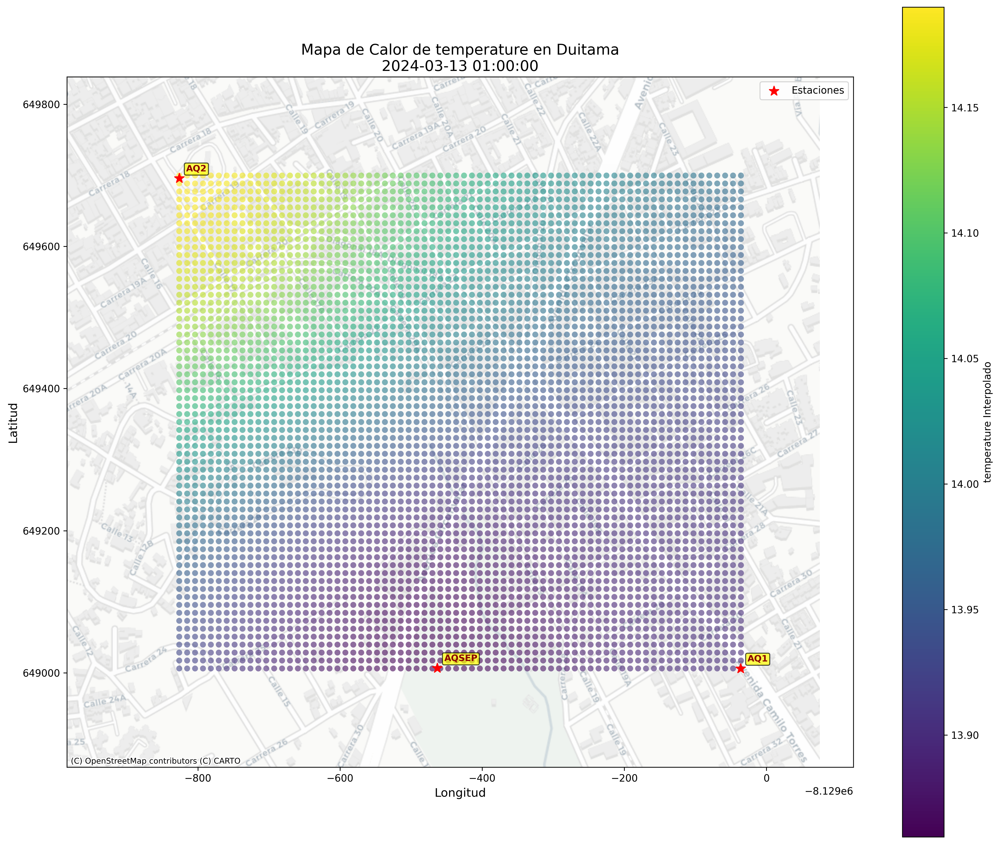

In [52]:
fig_pm25, ax_pm25, gdf_grid_pm25, gdf_stations_pm25 = plot_heatmap_geopandas(
    df_all, mesh_lat, mesh_lon, flat_points, t0, 'temperature',
    basemap_provider=cx.providers.CartoDB.Positron,
)
plt.show()

Estadísticas de humidity:
Mínimo: 64.01
Máximo: 79.51
Promedio: 72.00


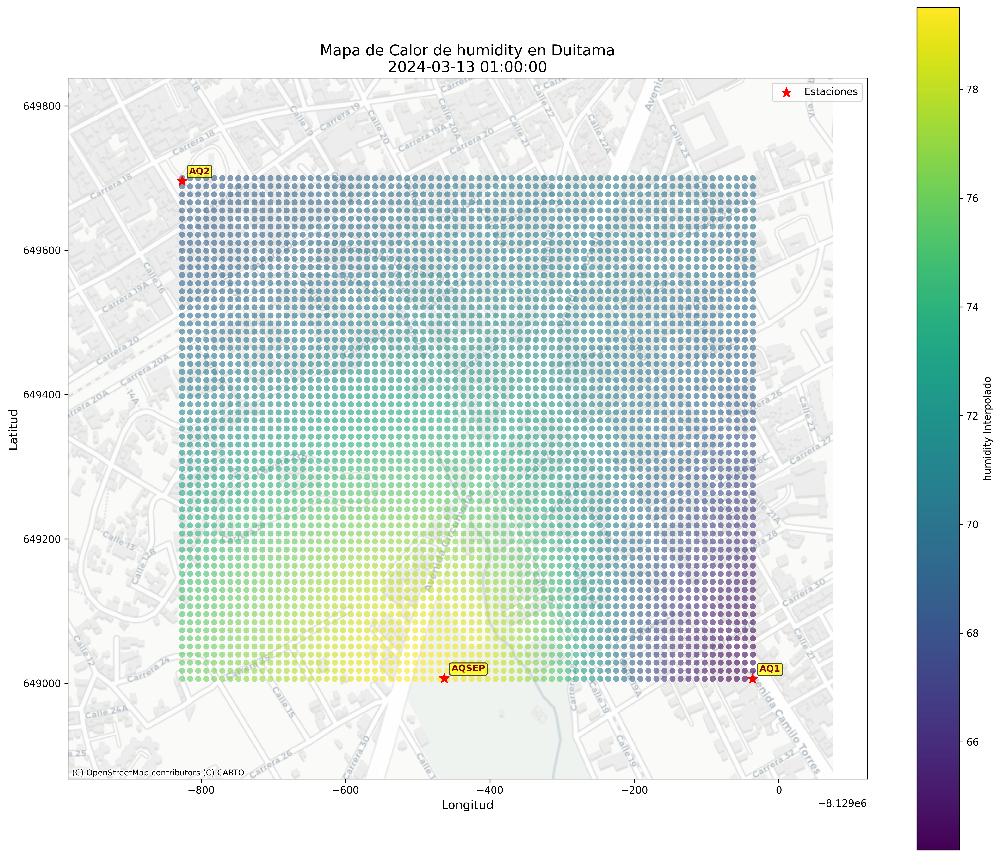

In [53]:
fig_pm25, ax_pm25, gdf_grid_pm25, gdf_stations_pm25 = plot_heatmap_geopandas(
    df_all, mesh_lat, mesh_lon, flat_points, t0, 'humidity',
    basemap_provider=cx.providers.CartoDB.Positron,
)
plt.show()